## Loading data and initial plotting

This notebook was used to write up some data loading functions and to play with plotting with altair. 

**Data source**

https://data.broadinstitute.org/chembank/assay/index.html

`AntibacterialAssay (1106)`, Sarah Stanley

Click file `FluorProtein(1106.0023)` to download

I believe this data is associated with the paper Identification of novel inhibitors of M. tuberculosis growth using whole cell based high-throughput screening, ACS Chem Biol
. 2012 Aug 17;7(8):1377-84. doi: 10.1021/cb300151m. Epub 2012 May 21. The paper uses a GFP-based assay for quantifying bacterial number. I believe the `FluorProtein` response column corresponds to GFP intensity, and is a proxy for cell number.  

**Before running the notebook, generate 2d descriptors for the chemicals in your dataset**

Follow the instructions in the readme to generate a csv containing molecule SMILES and 2d descriptors from cheminformatics package RDKIT.

The csv containing descriptors is the same length as the raw data file, and contains the same molecules but with reformatted SMILES.

In [1]:
import os
import random
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import altair as alt
from helpers import *


## EDA

In [2]:
data_raw = pd.read_csv("data/antibiotics/assay.1106.0023.tsv", sep="\t")
descriptors = pd.read_csv("data/antibiotics/assay.1106.0023_RDKit_2D.csv",)

data_w_descriptors = pd.concat([data_raw, descriptors], axis = 1) #todo: merge on smiles by including the original smiles in the output.csv file

In [3]:
descriptors.shape

(10368, 209)

The RDKIT code generates 208 2-D descriptors (features)

In [4]:
if False in data_w_descriptors.all().unique():
    print("0 values are present")
else:
    print(
        "No 0 values present"
    )  # will return False if 0 is present in one of the columns

if data_w_descriptors.isnull().values.any():
    print("Null values are present")
else:
    print("Null values are not present")

print(f"There are {data_w_descriptors.duplicated().sum()} duplicated rows")


0 values are present
Null values are present
There are 0 duplicated rows


In [5]:
data_w_descriptors.head()


,ASSAY_ID,ASSAY,PROJECT,PLATE,WELL,WELL_TYPE,RAW_VALUE_A,BSUB_VALUE_A,Z_SCORE_A,RAW_VALUE_B,...,fr_sulfide,fr_sulfonamd,fr_sulfone,fr_term_acetylene,fr_tetrazole,fr_thiazole,fr_thiocyan,fr_thiophene,fr_unbrch_alkane,fr_urea
0,1106.0023,FluorProtein(1106.0023),AntibacterialAssay,1106.0023.2001,A01,compound treatment,41.959,-7.93,-1.44,63.037,...,0,0,0,0,0,0,0,0,0,0
1,1106.0023,FluorProtein(1106.0023),AntibacterialAssay,1106.0023.2001,A02,compound treatment,46.695,-3.19,-0.58,59.127,...,0,0,0,0,0,0,0,0,0,0
2,1106.0023,FluorProtein(1106.0023),AntibacterialAssay,1106.0023.2001,A03,compound treatment,46.684,-3.20,-0.58,70.293,...,0,0,0,0,0,0,0,0,0,0
3,1106.0023,FluorProtein(1106.0023),AntibacterialAssay,1106.0023.2001,A04,compound treatment,49.007,-0.88,-0.16,58.374,...,0,0,0,0,0,0,0,1,0,0
4,1106.0023,FluorProtein(1106.0023),AntibacterialAssay,1106.0023.2001,A05,compound treatment,44.434,-5.45,-0.99,56.533,...,0,0,0,0,0,0,0,0,0,0


In [6]:
print(f"{data_w_descriptors.PLATE.nunique()} plates")

print(f"{data_w_descriptors.SMILES.nunique()} compounds")


27 plates
7560 compounds


In [7]:
data_w_descriptors.WELL_TYPE.unique()


array(['compound treatment', 'mock treatment'], dtype=object)

In [8]:
#replace NAN values in SMILE column for mock treatment

data_w_descriptors['SMILES'] = data_w_descriptors['SMILES'].fillna('mock')

In [9]:
summary_stats(
    data_raw,
    "PLATE",
)


Average number of observations per plate: 384


In [10]:
data_w_descriptors.RAW_VALUE_A.describe().round(2)


count    10368.00
mean        47.13
std         18.56
min          3.40
25%         43.06
50%         47.56
75%         51.55
max       1466.23
Name: RAW_VALUE_A, dtype: float64

IQR is ~43-52 units, but there is at least one value in the thousands of units. 

In [11]:
high_fluor = data_w_descriptors.loc[data_raw["RAW_VALUE_A"] > 100]
high_fluor


,ASSAY_ID,ASSAY,PROJECT,PLATE,WELL,WELL_TYPE,RAW_VALUE_A,BSUB_VALUE_A,Z_SCORE_A,RAW_VALUE_B,...,fr_sulfide,fr_sulfonamd,fr_sulfone,fr_term_acetylene,fr_tetrazole,fr_thiazole,fr_thiocyan,fr_thiophene,fr_unbrch_alkane,fr_urea
161,1106.0023,FluorProtein(1106.0023),AntibacterialAssay,1106.0023.2001,G18,compound treatment,133.351,83.5,15.17,132.365,...,0,0,0,0,0,0,0,0,0,0
706,1106.0023,FluorProtein(1106.0023),AntibacterialAssay,1106.0023.2002,N11,compound treatment,1466.233,1410.0,256.51,1397.903,...,0,0,0,0,0,0,0,0,0,0
1258,1106.0023,FluorProtein(1106.0023),AntibacterialAssay,1106.0023.2012,E11,compound treatment,334.691,283.0,51.50,402.633,...,0,0,0,0,0,0,0,0,0,0
1464,1106.0023,FluorProtein(1106.0023),AntibacterialAssay,1106.0023.2012,N01,compound treatment,125.521,74.2,13.49,106.658,...,1,0,0,0,0,0,0,0,0,0
1738,1106.0023,FluorProtein(1106.0023),AntibacterialAssay,1106.0023.2021,I11,compound treatment,556.463,502.0,91.25,559.499,...,0,0,0,0,0,0,0,0,0,0
4595,1106.0023,FluorProtein(1106.0023),AntibacterialAssay,1106.0023.2055,P12,compound treatment,101.618,53.4,9.70,100.426,...,1,0,0,0,0,0,0,1,0,0
6677,1106.0023,FluorProtein(1106.0023),AntibacterialAssay,1106.0023.2066,G06,compound treatment,104.728,48.1,8.74,91.854,...,1,0,0,0,0,0,0,1,0,0
7730,1106.0023,FluorProtein(1106.0023),AntibacterialAssay,1106.0023.2078,C03,compound treatment,117.491,77.4,14.06,110.897,...,0,0,0,0,0,0,0,0,0,0
7759,1106.0023,FluorProtein(1106.0023),AntibacterialAssay,1106.0023.2078,D08,compound treatment,123.200,83.1,15.10,144.808,...,1,0,0,0,0,0,0,0,0,0
8165,1106.0023,FluorProtein(1106.0023),AntibacterialAssay,1106.0023.2079,E06,compound treatment,760.612,707.0,128.40,830.369,...,0,0,0,0,0,0,0,0,0,0


In [12]:
print(f"{high_fluor.shape[0]} rows")


11 rows


In [13]:
print(f"{high_fluor.SMILES.nunique()} unique compounds")


11 unique compounds


These might be outliers, perhaps because the compounds are autofluorescent. Exclude these observations with > 200 units for now. 

In [14]:
data = data_w_descriptors.loc[data_raw["RAW_VALUE_A"] <= 200]

print(f"{(data_raw.shape[0]-data.shape[0])} rows excluded")


4 rows excluded


Distribution of response:

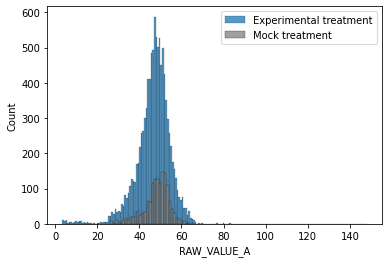

In [15]:
sns.histplot(data["RAW_VALUE_A"])
sns.histplot(
    data.query('WELL_TYPE == "mock treatment"')["RAW_VALUE_A"],
    color="grey",
    label="mock",
)
plt.legend(
    labels=["Experimental treatment", "Mock treatment"],
)


Subselect data to plot to avoid overplotting

In [16]:
random.seed(20220221)
plates = list(data.PLATE.unique())

plate_sample = random.sample(plates, 4)

data_sample = data.loc[data["PLATE"].isin(plate_sample)]


In [17]:
chart1 = (
    alt.Chart(data_sample)
    .mark_point(size=80)
    .encode(
        x="PLATE",
        y="RAW_VALUE_A",
        tooltip=["SMILES", "RAW_VALUE_A"],
    )
    .interactive()
    .properties(title="Response grouped by plate", width=800, height=300)
)

chart2 = (
    alt.Chart(data_sample.query('WELL_TYPE == "mock treatment"'))
    .mark_point(size=80)
    .encode(
        x="PLATE",
        y="RAW_VALUE_A",
        tooltip=["SMILES", "RAW_VALUE_A"],
        color=alt.value("grey"),
        shape=alt.Shape(
            "WELL_TYPE",
            title="Mock",
            scale=alt.Scale(
                domain=[
                    "mock treatment",
                ],
                range=[
                    "triangle",
                ],
            ),
        ),
    )
    .interactive()
    .properties(title="Response grouped by plate", width=800, height=300)
)


chart1 + chart2


alt.LayerChart(...)

In [18]:
MEDIAN_RESPONSE = (
    data_sample[["SMILES", "RAW_VALUE_A"]]
    .groupby("SMILES")
    .mean()
    .rename(columns={"RAW_VALUE_A": "RAW_VALUE_A_med"})
    .reset_index()
    .sort_values(by="RAW_VALUE_A_med")
)
compounds_ordered_by_median = list(MEDIAN_RESPONSE.SMILES)

chart = (
    alt.Chart(data_sample)
    .mark_point(size=50)
    .encode(
        x=alt.X(
            "SMILES", sort=compounds_ordered_by_median, axis=alt.Axis(labels=False)
        ),
        y=alt.Y("RAW_VALUE_A"),
        tooltip=["SMILES", "RAW_VALUE_A"],
        color="SMILES",
    )
    .interactive()
    .properties(width=800, height=300, title="Response for each compound")
)
chart.encoding.x.title = "Compound"
chart


alt.Chart(...)

## Feature selection

In [43]:
corr = descriptors.drop('smiles', axis=1).corr()

<AxesSubplot:>

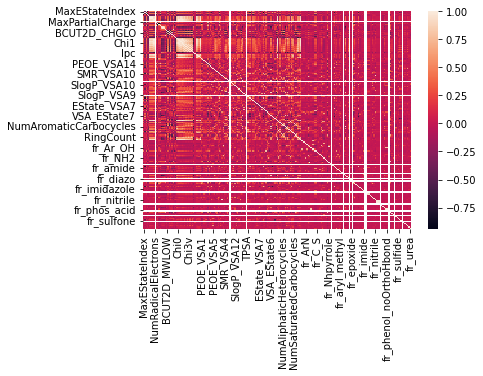

In [48]:
sns.heatmap(corr,)

As shown the heatmap above, there are several highly correlative features. This is not unexpected. For example, there are multiple features that count the number of phenol-type moities in the molecule.

Given the number of features and the fact that there is colinearity among some of the features, let's use dimension-reduction techniques in concert with regression to try to predict molecules that will have low fluorescence values (i.e., RAW_VALUE_A). 